In [2]:
from hnn_core import calcium_model, read_params, simulate_dipole, average_dipoles, jones_2009_model
from hnn_core.viz import plot_dipole
import matplotlib.pyplot as plt
from copy import deepcopy
import pandas as pd
import pickle
import numpy as np
from hnn_core import MPIBackend

In [3]:
# load params from original param file
with open('param_files/net_TEP_calcium_params_v4.pkl', 'rb') as f:
    V4_TEP_params = pickle.load(f)

print(V4_TEP_params)

{
    "L2Basket_Gauss_A_weight": 0.0,
    "L2Basket_Gauss_mu": 2000.0,
    "L2Basket_Gauss_sigma": 3.6,
    "L2Basket_Pois_A_weight_ampa": 0.0,
    "L2Basket_Pois_A_weight_nmda": 0.0,
    "L2Basket_Pois_lamtha": 0.0,
    "L2Pyr_Gauss_A_weight": 0.0,
    "L2Pyr_Gauss_mu": 2000.0,
    "L2Pyr_Gauss_sigma": 3.6,
    "L2Pyr_Pois_A_weight_ampa": 0.0,
    "L2Pyr_Pois_A_weight_nmda": 0.0,
    "L2Pyr_Pois_lamtha": 0.0,
    "L2Pyr_ampa_e": 0.0,
    "L2Pyr_ampa_tau1": 0.5,
    "L2Pyr_ampa_tau2": 5.0,
    "L2Pyr_apical1_L": 306.0,
    "L2Pyr_apical1_diam": 4.08,
    "L2Pyr_apicaloblique_L": 340.0,
    "L2Pyr_apicaloblique_diam": 3.91,
    "L2Pyr_apicaltrunk_L": 59.5,
    "L2Pyr_apicaltrunk_diam": 4.25,
    "L2Pyr_apicaltuft_L": 238.0,
    "L2Pyr_apicaltuft_diam": 3.4,
    "L2Pyr_basal1_L": 85.0,
    "L2Pyr_basal1_diam": 4.25,
    "L2Pyr_basal2_L": 255.0,
    "L2Pyr_basal2_diam": 2.72,
    "L2Pyr_basal3_L": 255.0,
    "L2Pyr_basal3_diam": 2.72,
    "L2Pyr_dend_Ra": 200.0,
    "L2Pyr_dend_cm": 0.619

In [2]:
# load params from original param file
fparams = "TEP_from_def_Liz_2newInputs_optimized.param"
original_params = read_params(fparams)

print(original_params)

{
    "L2Basket_Gauss_A_weight": 0.0,
    "L2Basket_Gauss_mu": 2000.0,
    "L2Basket_Gauss_sigma": 3.6,
    "L2Basket_Pois_A_weight_ampa": 0.0,
    "L2Basket_Pois_A_weight_nmda": 0.0,
    "L2Basket_Pois_lamtha": 0.0,
    "L2Pyr_Gauss_A_weight": 0.0,
    "L2Pyr_Gauss_mu": 2000.0,
    "L2Pyr_Gauss_sigma": 3.6,
    "L2Pyr_Pois_A_weight_ampa": 0.0,
    "L2Pyr_Pois_A_weight_nmda": 0.0,
    "L2Pyr_Pois_lamtha": 0.0,
    "L2Pyr_ampa_e": 0.0,
    "L2Pyr_ampa_tau1": 0.5,
    "L2Pyr_ampa_tau2": 5.0,
    "L2Pyr_apical1_L": 306.0,
    "L2Pyr_apical1_diam": 4.08,
    "L2Pyr_apicaloblique_L": 340.0,
    "L2Pyr_apicaloblique_diam": 3.91,
    "L2Pyr_apicaltrunk_L": 59.5,
    "L2Pyr_apicaltrunk_diam": 4.25,
    "L2Pyr_apicaltuft_L": 238.0,
    "L2Pyr_apicaltuft_diam": 3.4,
    "L2Pyr_basal1_L": 85.0,
    "L2Pyr_basal1_diam": 4.25,
    "L2Pyr_basal2_L": 255.0,
    "L2Pyr_basal2_diam": 2.72,
    "L2Pyr_basal3_L": 255.0,
    "L2Pyr_basal3_diam": 2.72,
    "L2Pyr_dend_Ra": 200.0,
    "L2Pyr_dend_cm": 0.619

In [3]:
# load params from TEP simulation
with open('param_files/net_TEP_calcium_params.pkl', 'rb') as f:
    TEP_params = pickle.load(f)

In [4]:
net = calcium_model(params=V4_TEP_params, add_drives_from_params=True)

<h1>TEP with Jones 2009

In [32]:
original_net = jones_2009_model(params=original_params, add_drives_from_params=True)
with MPIBackend(n_procs=1, mpi_cmd='mpiexec'):
    dpl = simulate_dipole(original_net, tstop=200, n_trials=1,dt=0.025,record_vsec='all',record_isec='all',record_ca='all')[0]


window_len, scaling_factor = 20, 3000
smoothed_dpl = deepcopy(dpl)
smoothed_dpl.smooth(window_len).scale(scaling_factor)

/opt/anaconda3/lib/python3.12/site-packages/hnn_core/parallel_backends.py:633: UserWarning: mpi4py not installed. Will run on single processor
  warn(f'{packages} not installed. Will run on single processor')


MPIBackend is set to use 1 core: transferring the simulation to JoblibBackend....
Joblib will run 1 trial(s) in parallel by distributing trials over 1 jobs.
Building the NEURON model
[Done]
Trial 1: 0.03 ms...
Trial 1: 10.0 ms...
Trial 1: 20.0 ms...
Trial 1: 30.0 ms...
Trial 1: 40.0 ms...
Trial 1: 50.0 ms...
Trial 1: 60.0 ms...
Trial 1: 70.0 ms...
Trial 1: 80.0 ms...
Trial 1: 90.0 ms...
Trial 1: 100.0 ms...
Trial 1: 110.0 ms...
Trial 1: 120.0 ms...
Trial 1: 130.0 ms...
Trial 1: 140.0 ms...
Trial 1: 150.0 ms...
Trial 1: 160.0 ms...
Trial 1: 170.0 ms...
Trial 1: 180.0 ms...
Trial 1: 190.0 ms...


In [33]:
gids = original_net.gid_ranges
gids['L5_pyramidal']

# find the gids of the neurons that spiked
# l5_gids = gids[np.where(((gids > 169).astype(float) + (gids <=270).astype(float)) == 2)[0]]
l5_gids = gids['L5_pyramidal']
l5_unique_gids = np.array([])
for l5 in l5_gids:
    if ~np.isin(l5,l5_unique_gids):
        l5_unique_gids = np.append(l5_unique_gids, l5)

# get calcium for each cell 
ca_l5_tuft = np.zeros((l5_unique_gids.shape[0], len(original_net.cell_response.times)))
ca_l5_apcl2 = np.zeros((l5_unique_gids.shape[0], len(original_net.cell_response.times)))
vltg_l5_soma = np.zeros((l5_unique_gids.shape[0], len(original_net.cell_response.times)))
ca_l5_soma = np.zeros((l5_unique_gids.shape[0], len(original_net.cell_response.times)))

for i, g in enumerate(l5_unique_gids.astype(int)):
    ca_l5_tuft[i] = original_net.cell_response.ca[0][g]['apical_tuft']
    ca_l5_apcl2[i] = original_net.cell_response.ca[0][g]['apical_2']
    ca_l5_soma[i] = original_net.cell_response.ca[0][g]['apical_2']
    vltg_l5_soma[i] = original_net.cell_response.vsec[0][g]['soma']

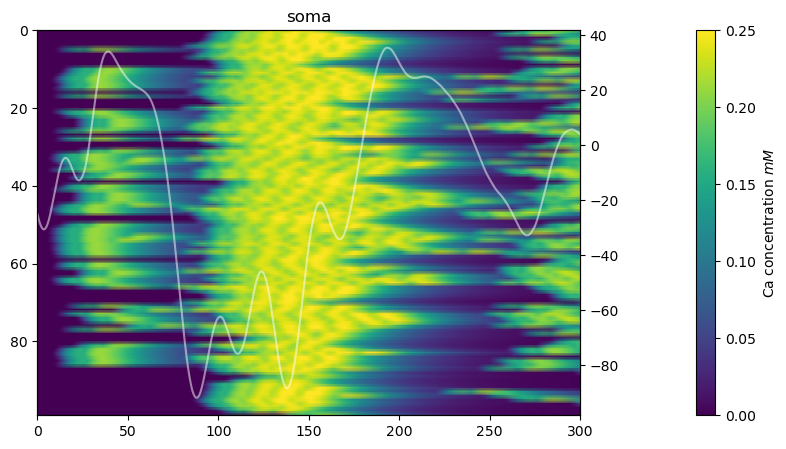

In [38]:
timevec = np.arange(0,8001,1)
# calcium concentration
fig, ax = plt.subplots(figsize=(10, 5))
im = ax.pcolormesh(timevec,np.arange(len(l5_unique_gids)),ca_l5_soma, shading='gouraud',vmin=0, vmax=0.25)
ax.invert_yaxis()
ax.set_title('soma')
cb = plt.colorbar(im, ax= ax, pad=0.15)
cb.set_label('Ca concentration $mM$')

# convert x ticks
ax.set_xticks(np.linspace(timevec[0], timevec[-1], 7))
ax.set_xticklabels(np.linspace(0, 300, 7).astype(int))

ax2 = ax.twinx()
ax2.plot(timevec,smoothed_dpl.data['agg'], color=(1,1,1), alpha=0.5) 



<h1> TEP with calcium model

In [5]:
from hnn_core import JoblibBackend

with JoblibBackend(n_jobs=2):
    dpl = simulate_dipole(net, tstop=300, n_trials=2,dt=0.025,record_vsec='all',record_isec='all',record_ca='all')

Joblib will run 2 trial(s) in parallel by distributing trials over 2 jobs.
Loading custom mechanism files from /opt/anaconda3/lib/python3.12/site-packages/hnn_core/mod/arm64/.libs/libnrnmech.so
Loading custom mechanism files from /opt/anaconda3/lib/python3.12/site-packages/hnn_core/mod/arm64/.libs/libnrnmech.so
Building the NEURON model
Building the NEURON model
[Done]
[Done]
Trial 1: 0.03 ms...
Trial 2: 0.03 ms...
Trial 2: 10.0 ms...
Trial 1: 10.0 ms...
Trial 2: 20.0 ms...
Trial 1: 20.0 ms...
Trial 2: 30.0 ms...
Trial 1: 30.0 ms...
Trial 2: 40.0 ms...
Trial 1: 40.0 ms...
Trial 2: 50.0 ms...
Trial 1: 50.0 ms...
Trial 2: 60.0 ms...
Trial 1: 60.0 ms...
Trial 2: 70.0 ms...
Trial 1: 70.0 ms...
Trial 2: 80.0 ms...
Trial 1: 80.0 ms...
Trial 2: 90.0 ms...
Trial 1: 90.0 ms...
Trial 2: 100.0 ms...
Trial 1: 100.0 ms...
Trial 2: 110.0 ms...
Trial 1: 110.0 ms...
Trial 2: 120.0 ms...
Trial 1: 120.0 ms...
Trial 2: 130.0 ms...
Trial 1: 130.0 ms...
Trial 2: 140.0 ms...
Trial 1: 140.0 ms...
Trial 2: 15

In [7]:
window_len, scaling_factor = 20, 1
smoothed_dpl = deepcopy(dpl)
smoothed_dpl = [dpl.smooth(window_len).scale(scaling_factor) for dpl in smoothed_dpl]

In [8]:
gids = net.gid_ranges
gids['L5_pyramidal']

range(170, 270)

In [9]:
# find the gids of the neurons that spiked
# l5_gids = gids[np.where(((gids > 169).astype(float) + (gids <=270).astype(float)) == 2)[0]]
l5_gids = gids['L5_pyramidal']
l5_unique_gids = np.array([])
for l5 in l5_gids:
    if ~np.isin(l5,l5_unique_gids):
        l5_unique_gids = np.append(l5_unique_gids, l5)

# get calcium for each cell 
ca_l5_tuft = np.zeros((l5_unique_gids.shape[0], len(net.cell_response.times)))
ca_l5_apcl2 = np.zeros((l5_unique_gids.shape[0], len(net.cell_response.times)))
vltg_l5_soma = np.zeros((l5_unique_gids.shape[0], len(net.cell_response.times)))
ca_l5_soma = np.zeros((l5_unique_gids.shape[0], len(net.cell_response.times)))

for i, g in enumerate(l5_unique_gids.astype(int)):
    ca_l5_tuft[i] = net.cell_response.ca[1][g]['apical_tuft']
    ca_l5_apcl2[i] = net.cell_response.ca[1][g]['apical_2']
    ca_l5_soma[i] = net.cell_response.ca[1][g]['apical_2']
    vltg_l5_soma[i] = net.cell_response.vsec[1][g]['soma']

In [10]:
net.cell_response.ca[1]

{0: {},
 1: {},
 2: {},
 3: {},
 4: {},
 5: {},
 6: {},
 7: {},
 8: {},
 9: {},
 10: {},
 11: {},
 12: {},
 13: {},
 14: {},
 15: {},
 16: {},
 17: {},
 18: {},
 19: {},
 20: {},
 21: {},
 22: {},
 23: {},
 24: {},
 25: {},
 26: {},
 27: {},
 28: {},
 29: {},
 30: {},
 31: {},
 32: {},
 33: {},
 34: {},
 35: {},
 36: {},
 37: {},
 38: {},
 39: {},
 40: {},
 41: {},
 42: {},
 43: {},
 44: {},
 45: {},
 46: {},
 47: {},
 48: {},
 49: {},
 50: {},
 51: {},
 52: {},
 53: {},
 54: {},
 55: {},
 56: {},
 57: {},
 58: {},
 59: {},
 60: {},
 61: {},
 62: {},
 63: {},
 64: {},
 65: {},
 66: {},
 67: {},
 68: {},
 69: {},
 70: {},
 71: {},
 72: {},
 73: {},
 74: {},
 75: {},
 76: {},
 77: {},
 78: {},
 79: {},
 80: {},
 81: {},
 82: {},
 83: {},
 84: {},
 85: {},
 86: {},
 87: {},
 88: {},
 89: {},
 90: {},
 91: {},
 92: {},
 93: {},
 94: {},
 95: {},
 96: {},
 97: {},
 98: {},
 99: {},
 100: {},
 101: {},
 102: {},
 103: {},
 104: {},
 105: {},
 106: {},
 107: {},
 108: {},
 109: {},
 110: {},


In [11]:
l5_unique_gids

array([170., 171., 172., 173., 174., 175., 176., 177., 178., 179., 180.,
       181., 182., 183., 184., 185., 186., 187., 188., 189., 190., 191.,
       192., 193., 194., 195., 196., 197., 198., 199., 200., 201., 202.,
       203., 204., 205., 206., 207., 208., 209., 210., 211., 212., 213.,
       214., 215., 216., 217., 218., 219., 220., 221., 222., 223., 224.,
       225., 226., 227., 228., 229., 230., 231., 232., 233., 234., 235.,
       236., 237., 238., 239., 240., 241., 242., 243., 244., 245., 246.,
       247., 248., 249., 250., 251., 252., 253., 254., 255., 256., 257.,
       258., 259., 260., 261., 262., 263., 264., 265., 266., 267., 268.,
       269.])

In [12]:
timevec = np.arange(0,12001,1)


Text(0, 0.5, 'Dipole moment (nAm)')

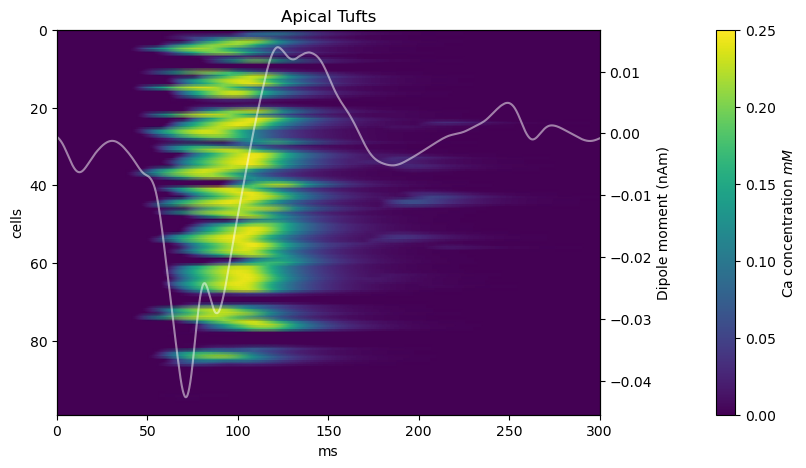

In [17]:
# calcium concentration
fig, ax = plt.subplots(figsize=(10, 5))
im = ax.pcolormesh(timevec,np.arange(len(l5_unique_gids)),ca_l5_tuft, shading='gouraud',vmin=0, vmax=0.25)
ax.invert_yaxis()
ax.set_title('Apical Tufts')
ax.set_xlabel('ms')
ax.set_ylabel('cells')

# add colorbar
cb = plt.colorbar(im, ax= ax, pad=0.15)
cb.set_label('Ca concentration $mM$')

# convert x ticks
ax.set_xticks(np.linspace(timevec[0], timevec[-1], 7))
ax.set_xticklabels(np.linspace(0, 300, 7).astype(int))

# plot the dipole
ax2 = ax.twinx()
ax2.plot(timevec,smoothed_dpl[0].data['agg'], color=(1,1,1), alpha=0.5)
ax2.set_ylabel('Dipole moment (nAm)')

In [33]:
smoothed_dpl.nave

1